In [1]:
from pathlib import Path
from datetime import datetime, timedelta

import cartopy
import cartopy.feature as cfeature
import matplotlib.pyplot as plt
from matplotlib.animation import ArtistAnimation
from matplotlib.colors import Normalize
from metpy.plots import USSTATES, USCOUNTIES, ctables, colortables
import numpy as np
from siphon.catalog import TDSCatalog
from siphon.cdmr import Dataset
from siphon.radarserver import RadarServer
from datetime import datetime
from dateutil import tz

In [2]:
cat = TDSCatalog('https://thredds.ucar.edu/thredds/radarServer/catalog.xml')

In [3]:
rs = RadarServer(cat.catalog_refs['NEXRAD Level III Radar from IDD'].href)

In [4]:
station = 'DIX'
query = rs.query()
now = datetime.utcnow()
query.stations(station).time_range(now - timedelta(hours=2), now).variables('N0Q')

var=N0Q&time_start=2020-08-04T14%3A49%3A32.305519&time_end=2020-08-04T16%3A49%3A32.305519&stn=DIX

In [5]:
query_cat = rs.get_catalog(query)

In [6]:
print(sorted(query_cat.datasets))

['Level3_DIX_N0Q_20200804_1450.nids', 'Level3_DIX_N0Q_20200804_1451.nids', 'Level3_DIX_N0Q_20200804_1453.nids', 'Level3_DIX_N0Q_20200804_1455.nids', 'Level3_DIX_N0Q_20200804_1457.nids', 'Level3_DIX_N0Q_20200804_1459.nids', 'Level3_DIX_N0Q_20200804_1501.nids', 'Level3_DIX_N0Q_20200804_1502.nids', 'Level3_DIX_N0Q_20200804_1504.nids', 'Level3_DIX_N0Q_20200804_1506.nids', 'Level3_DIX_N0Q_20200804_1508.nids', 'Level3_DIX_N0Q_20200804_1510.nids', 'Level3_DIX_N0Q_20200804_1512.nids', 'Level3_DIX_N0Q_20200804_1513.nids', 'Level3_DIX_N0Q_20200804_1515.nids', 'Level3_DIX_N0Q_20200804_1517.nids', 'Level3_DIX_N0Q_20200804_1519.nids', 'Level3_DIX_N0Q_20200804_1521.nids', 'Level3_DIX_N0Q_20200804_1523.nids', 'Level3_DIX_N0Q_20200804_1524.nids', 'Level3_DIX_N0Q_20200804_1526.nids', 'Level3_DIX_N0Q_20200804_1528.nids', 'Level3_DIX_N0Q_20200804_1530.nids', 'Level3_DIX_N0Q_20200804_1532.nids', 'Level3_DIX_N0Q_20200804_1534.nids', 'Level3_DIX_N0Q_20200804_1535.nids', 'Level3_DIX_N0Q_20200804_1537.nids', 

In [7]:
def plot_radar(data, field_name):
    rng = data.variables['gate'][:]
    az = data.variables['azimuth'][:]
    ref = data.variables[field_name][:]
    
    offset_in_degrees_latitude = 1.7
    offset_in_degrees_longitude = 3.4
    ax.set_extent([data.RadarLongitude - offset_in_degrees_longitude,
                   data.RadarLongitude + offset_in_degrees_longitude,
                   data.RadarLatitude - offset_in_degrees_latitude,
                   data.RadarLatitude + offset_in_degrees_latitude])
                   
    ax.set_adjustable('datalim')
    ax.outline_patch.set_visible(False)
    
    x = rng * np.sin(np.deg2rad(az))[:, None]
    y = rng * np.cos(np.deg2rad(az))[:, None]
    
    cmap = colortables.get_colortable('NWSReflectivity')
    
    mesh = ax.pcolormesh(x, y, ref, cmap=cmap, norm=Normalize(-1, 80), zorder=0)
    
    return mesh

    
def convert_datetime_to_local(string):
    from_zone = tz.gettz('UTC')
    to_zone = tz.gettz('America/New_York')
    utc_time = datetime.strptime(string, '%Y-%m-%dT%H:%M:%SZ').replace(tzinfo=from_zone)
    eastern = utc_time.astimezone(to_zone)
    date_time = datetime.strftime(eastern, '%a, %b %d, %Y %I:%M %p').lstrip('0').replace(' 0', ' ')
    return date_time

In [8]:
field_name = 'BaseReflectivityDR'
base_file = query_cat.datasets[0].remote_access()
proj = cartopy.crs.LambertConformal(central_longitude=base_file.RadarLongitude,
                                    central_latitude=base_file.RadarLatitude)

county_borders = USCOUNTIES.with_scale('20m')

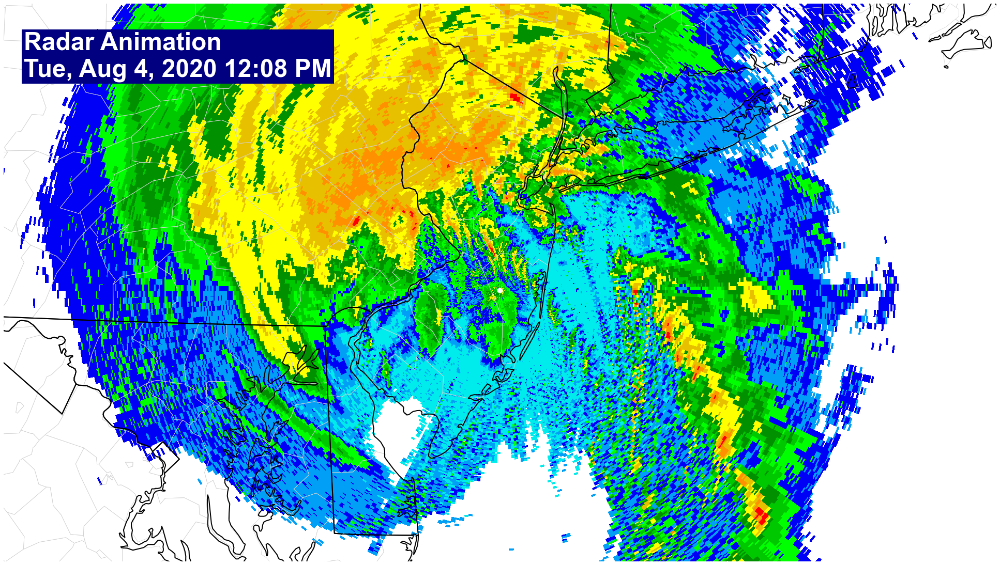

In [9]:
fig = plt.figure(figsize=(1920/72, 1080/72))
ax = fig.add_axes([0, 0, 1, 1], projection=proj)

artists = []

ax.add_feature(cfeature.STATES.with_scale('10m'), linewidth=2, zorder=2)
ax.add_feature(county_borders, edgecolor='lightgray', zorder=1, linewidth=0.75)

for ds_name in sorted(query_cat.datasets):
    ds = query_cat.datasets[ds_name]
    data = Dataset(ds.access_urls['CdmRemote'])
    
    field_name = [var.name for var in data.variables.values()
                  if var.ndim >=2 and not var.name.endswith('RAW')][0]
    
    text = ax.text(0.02, 0.95, s=f'Radar Animation\n{convert_datetime_to_local(data.time_coverage_start)}',
                   fontsize=48, fontweight='bold', fontname='Arial',
                   color='white', bbox={'facecolor':'navy', 'alpha':1.0, 'edgecolor': 'none'},
                   transform=ax.transAxes, zorder=10, va='top')
    
    mesh = plot_radar(data, field_name)
    
    artists.append([text, mesh])

In [10]:
plt.rcParams['animation.html'] = 'jshtml'

In [11]:
anim = ArtistAnimation(fig, artists, interval=150, repeat_delay=2000)
anim

In [12]:
graphics_dir = Path('.') / '..' / '..' / 'graphics' / 'radar'
anim.save(f'{graphics_dir}/{station}_radar_animation.mp4', writer='ffmpeg')